In [1]:
from __future__ import division

import os
import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib.pylab as plt
from keras.preprocessing import image

Using TensorFlow backend.
/Users/reubenfeinman/anaconda/lib/python3.6/importlib/_bootstrap.py:205: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [2]:
def load_image_dataset(nb_categories, nb_exemplars, data_folder,
                        target_size=(200, 200)):
    # First load the images
    imgs = []
    files = [file for file in os.listdir(data_folder) if file.endswith('png')]
    files = sorted(files)
    for file in files:
        img_path = os.path.join(data_folder, file)
        img = image.load_img(img_path, target_size=target_size,
                             interpolation='bicubic')
        imgs.append(image.img_to_array(img))
    imgs = np.asarray(imgs)
    imgs /= 255.
    # Now load the feature info
    feature_file = os.path.join(data_folder, 'data.csv')
    df = pd.read_csv(feature_file, index_col=0)
    # Collect a subset of the data according to nb_categories, nb_exemplars
    ix = []
    for cat in range(nb_categories):
        ix_cat = df[df['shape'] == cat].index.tolist()
        ix_cat = ix_cat[:nb_exemplars+1]
        ix.extend(ix_cat)
    imgs = imgs[ix]
    df = df.iloc[ix]

    return imgs, df['shape'].as_matrix()

In [14]:
nb_categories = 10
nb_exemplars = 2
data_folder = '../data/images_generated/'
imgs, df = load_image_dataset(nb_categories, nb_exemplars, data_folder, target_size=(300,300))

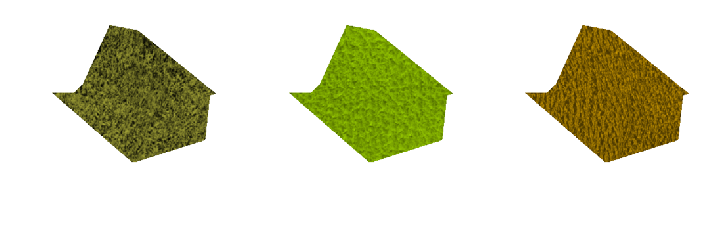

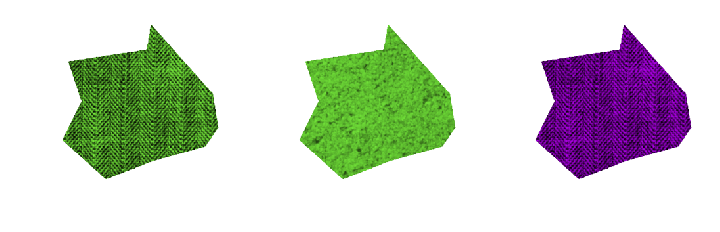

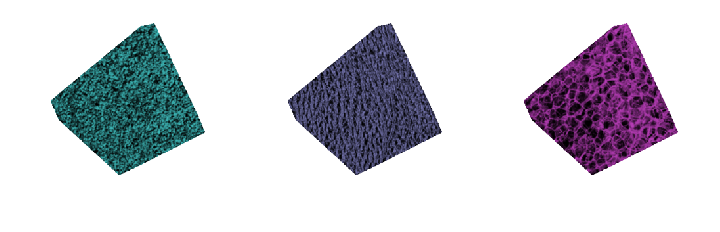

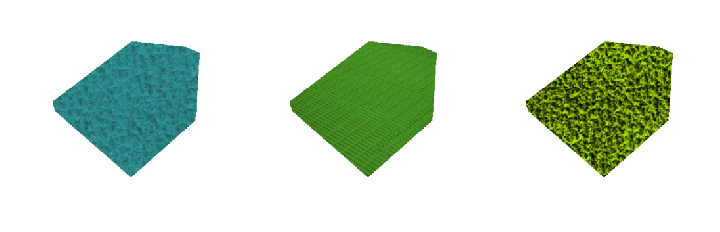

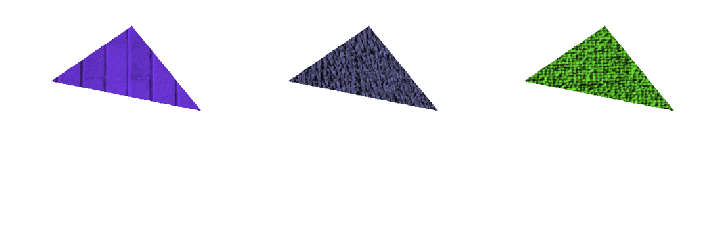

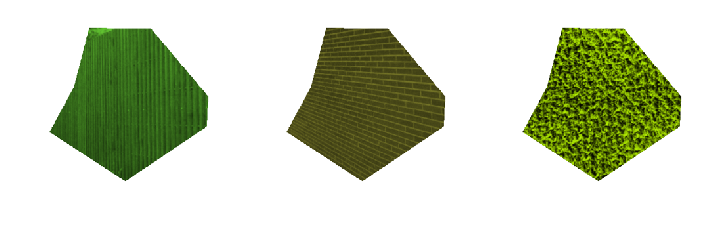

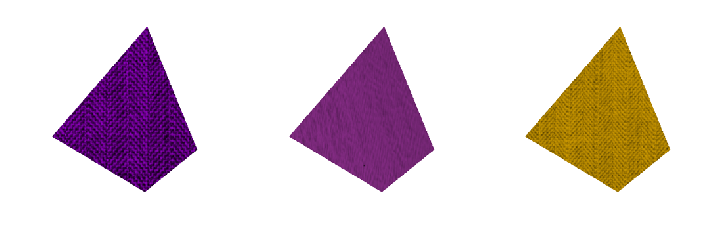

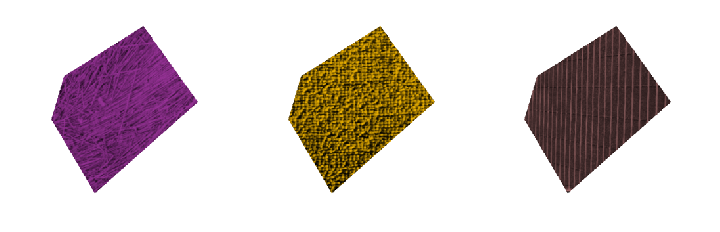

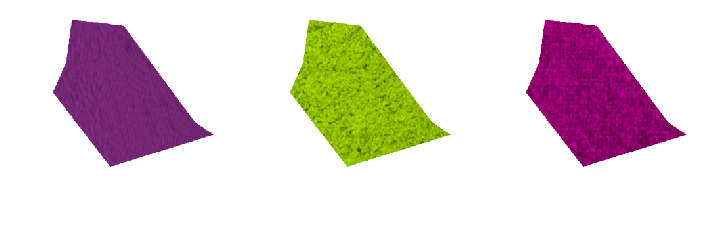

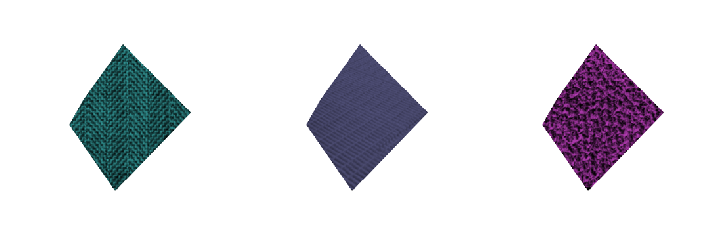

In [15]:
for i in range(nb_categories):
    fig, axes = plt.subplots(nrows=1, ncols=nb_exemplars+1, figsize=(12, 4))
    for j in range(nb_exemplars+1):
        axes[j].imshow(imgs[i*(nb_exemplars+1)+j])
        axes[j].axis('off')
    plt.show()

## Verify Textures

### This is the Brodatz textures

In [ ]:
# We need to normalize the textures so that same colors are actually the same... let's do that here

In [23]:
def load_texture_dataset(data_folder, target_size=(200, 200)):
    # First load the images
    imgs = []
    files = [file for file in os.listdir(data_folder) if file.endswith('tiff')]
    files = sorted(files)
    for file in files:
        img_path = os.path.join(data_folder, file)
        img = image.load_img(img_path, target_size=target_size, interpolation='bicubic')
        imgs.append(image.img_to_array(img))
    return np.asarray(imgs)/255., files

In [60]:
textures, files = load_texture_dataset('../data/textures', (300, 300))

In [83]:
np.mean(textures)

0.57248026

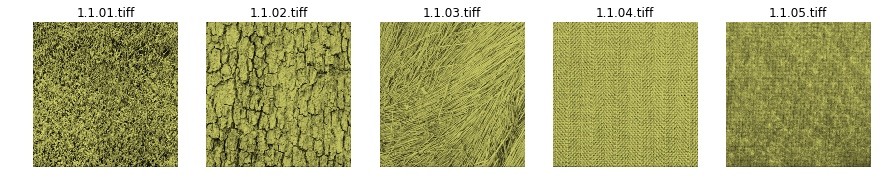

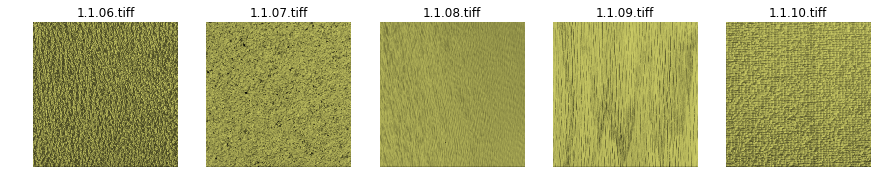

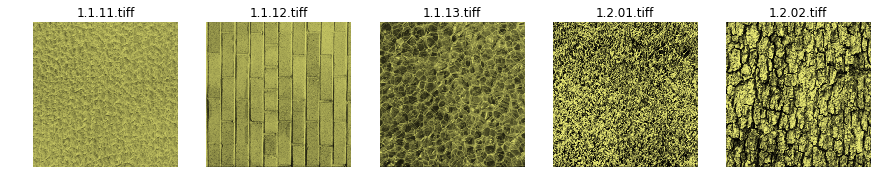

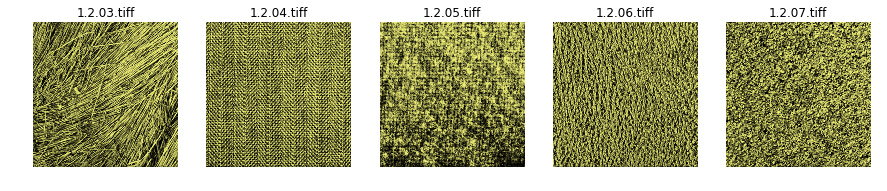

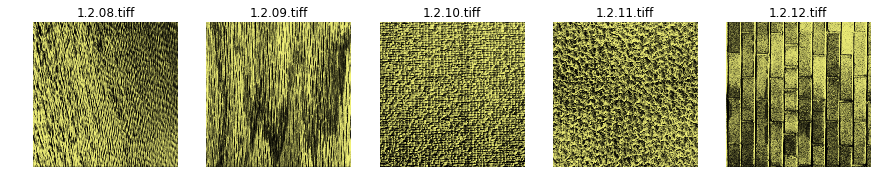

...

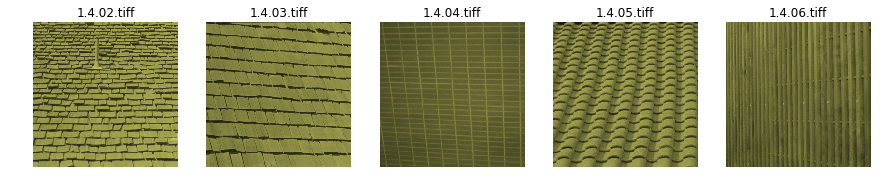

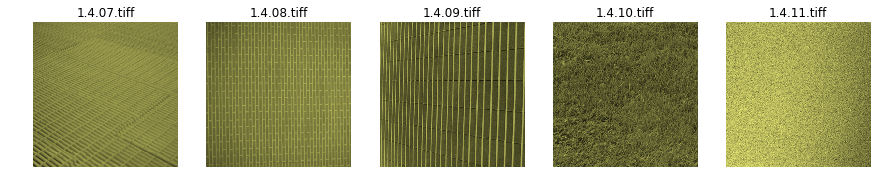

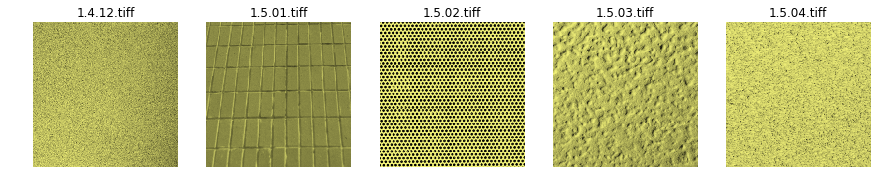

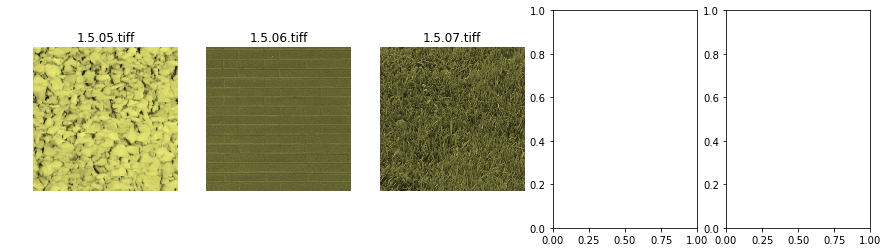

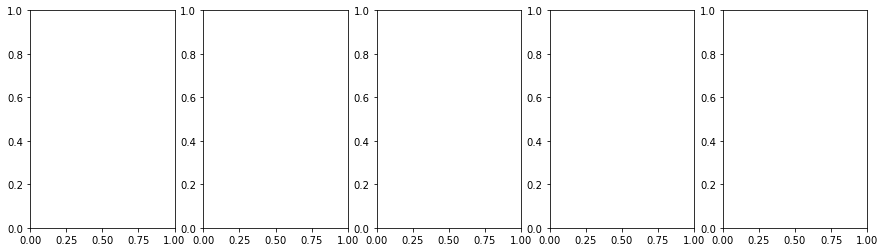

In [81]:
#color = np.random.uniform(size=(3,))
color = np.asarray([ 0.95  ,  0.95  ,  0.475 ])
for i in range(13):
    fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(15, 4))
    for j in range(5):
        if i*5+j < 58:
            axes[j].imshow(color*textures[i*5+j])
            axes[j].axis('off')
            axes[j].set_title(files[i*5+j])
    plt.show()

In [65]:
# let's normalize them
def normalize(textures):
    """
    textures are shape (N, Width, Height, 3)
    """
    textures_p = np.zeros_like(textures)
    total_mean = np.mean(textures)
    for i in range(len(textures)):
        tex_mean = np.mean(textures[i])
        textures_p[i] = textures[i]*(total_mean/tex_mean)
    return np.minimum(textures_p, 1)

In [66]:
textures_norm = normalize(textures)

In [70]:
print([np.mean(t) for t in textures])

[0.50461447, 0.58242565, 0.6147868, 0.68067038, 0.57122713, 0.50535071, 0.61059195, 0.63299191, 0.70040321, 0.61974746, 0.6505568, 0.62035531, 0.43678063, 0.5011996, 0.50052351, 0.50055575, 0.50977069, 0.5010668, 0.50140375, 0.50737536, 0.51018363, 0.50541544, 0.50117093, 0.50516945, 0.50242561, 0.50260752, 0.63573766, 0.65758502, 0.68718052, 0.32683077, 0.43728617, 0.60368168, 0.75012231, 0.7138893, 0.87652963, 0.79874241, 0.7236442, 0.79308617, 0.62213564, 0.4244796, 0.51875681, 0.50547224, 0.39260167, 0.48447141, 0.41532308, 0.5489437, 0.52119261, 0.39867204, 0.37622055, 0.68322021, 0.71254754, 0.55675972, 0.63277406, 0.72394741, 0.83458531, 0.78126782, 0.41825578, 0.36852455]


In [69]:
print([np.mean(t) for t in textures_norm])

[0.57234865, 0.57248026, 0.57248032, 0.57248032, 0.57248014, 0.5724802, 0.5724802, 0.5724802, 0.57248026, 0.5724802, 0.5724802, 0.57248032, 0.57179701, 0.56675225, 0.56557149, 0.56640834, 0.56773895, 0.56750017, 0.56863409, 0.56728899, 0.56748718, 0.56658542, 0.56564641, 0.56680816, 0.56589401, 0.56602776, 0.57248026, 0.5724802, 0.5724802, 0.56307262, 0.57074404, 0.5724802, 0.57248038, 0.5724802, 0.57248014, 0.57248032, 0.5724802, 0.57248026, 0.57248014, 0.57248026, 0.57248038, 0.57248026, 0.57248038, 0.57248014, 0.57248026, 0.57248026, 0.57248026, 0.57127452, 0.57244378, 0.57248014, 0.5724802, 0.5724802, 0.57248026, 0.57248026, 0.57248026, 0.57248026, 0.57248026, 0.57233632]


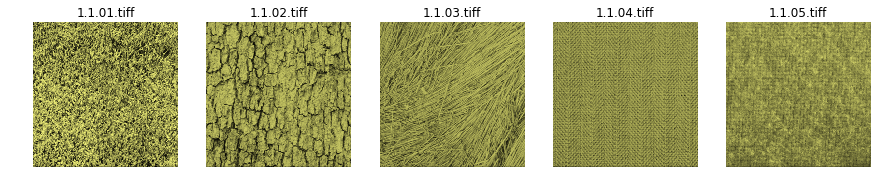

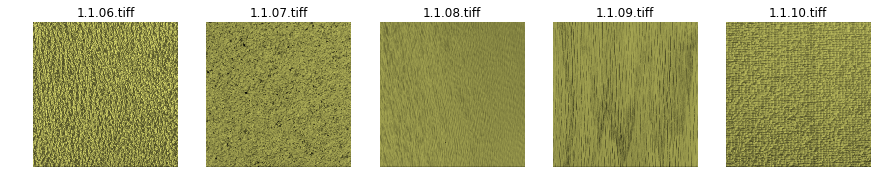

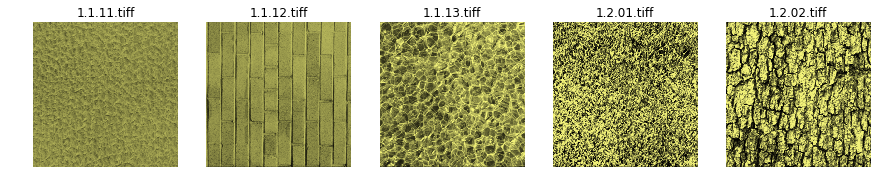

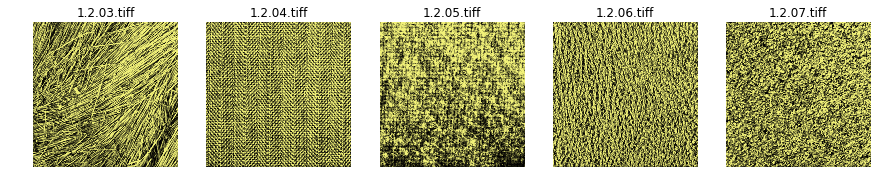

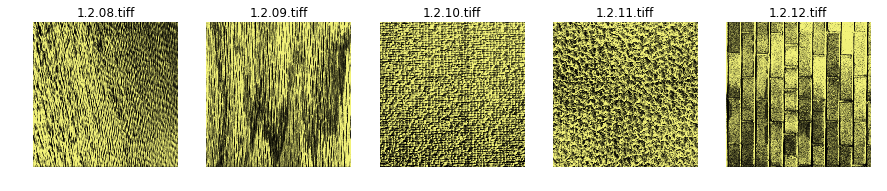

...

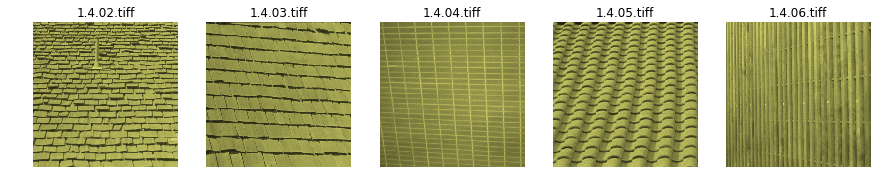

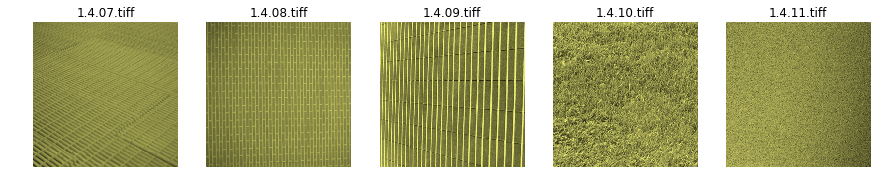

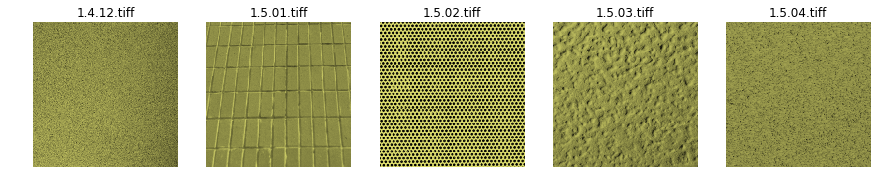

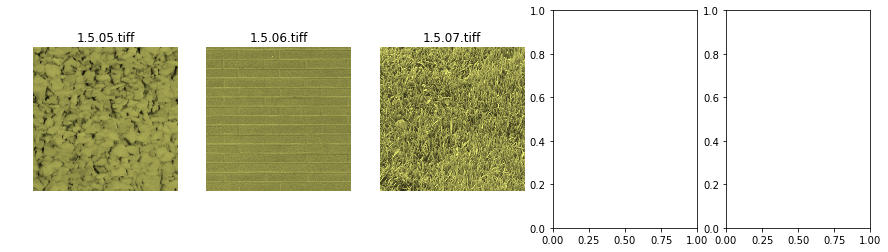

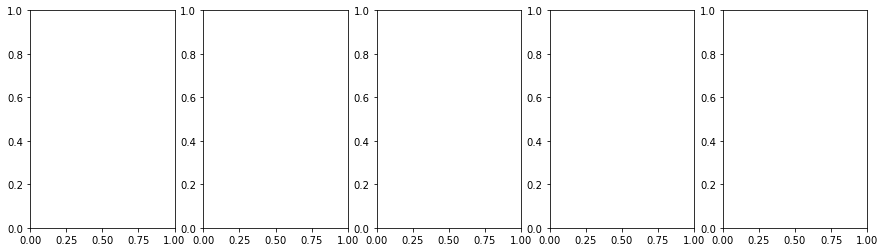

In [82]:
for i in range(13):
    fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(15, 4))
    for j in range(5):
        if i*5+j < 58:
            axes[j].imshow(color*textures_norm[i*5+j])
            axes[j].axis('off')
            axes[j].set_title(files[i*5+j])
    plt.show()

### This is for the VisionTexture dataset

In [4]:
from scipy.misc import imread

In [21]:
def get_images(data_folder):
    for subfolder in os.listdir(data_folder):
        print(subfolder)
        # Collect the images in this subfolder
        imgs = []
        sf_path = os.path.join(data_folder, subfolder)
        if os.path.isdir(sf_path):
            for f in os.listdir(sf_path):
                if f.endswith('ppm'):
                    img_path = os.path.join(sf_path, f)
                    img = image.load_img(img_path, target_size=(300,300), interpolation='bicubic')
                    imgs.append(image.img_to_array(img))
        imgs = np.asarray(imgs) / 255.
        print(imgs.shape)
        # Plot the images
        fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(15,12))
        for i in range(4):
            for j in range(5):
                if 5*i+j < len(imgs):
                    axes[i,j].imshow(imgs[5*i+j])
                    axes[i,j].axis('off')
        plt.show()
        print('\n')

Bark
(13, 300, 300, 3)


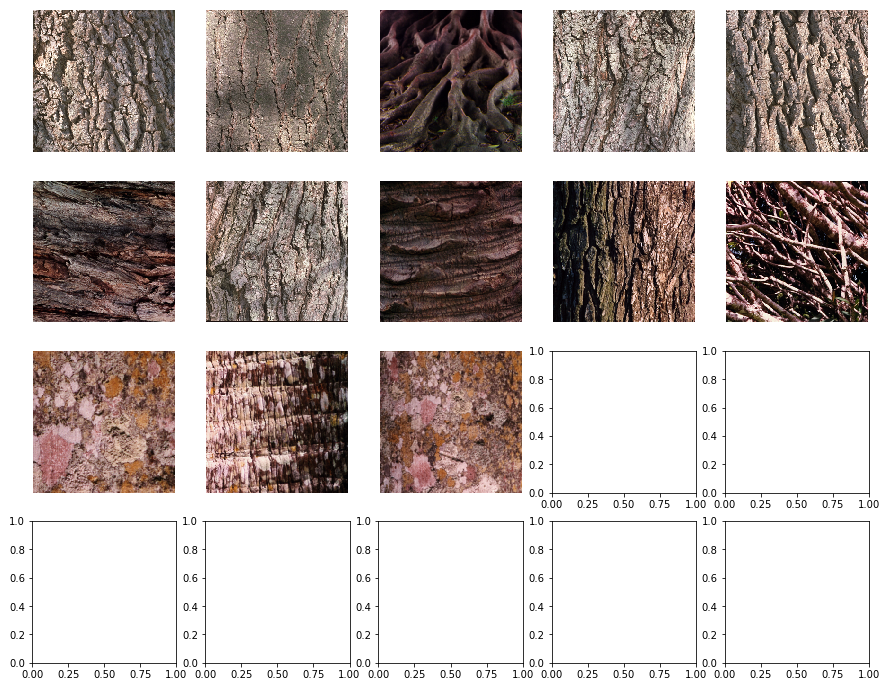



Wood
(3, 300, 300, 3)


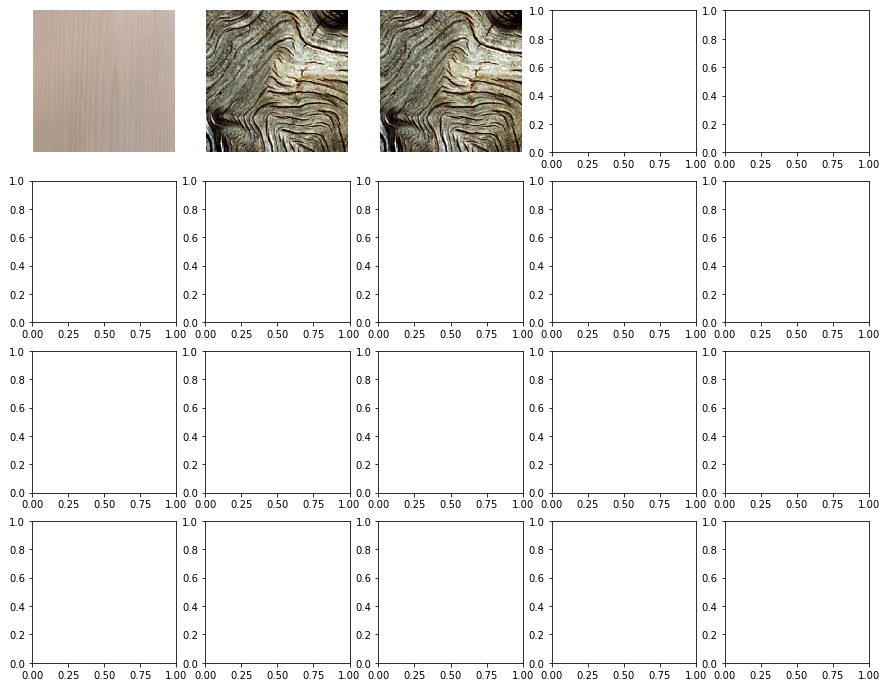



Misc
(4, 300, 300, 3)


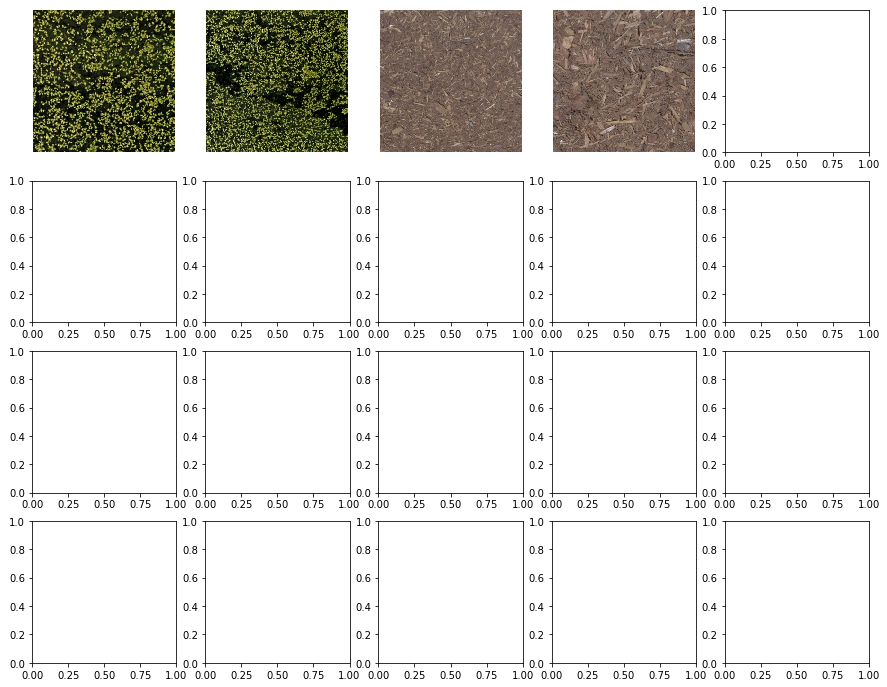



Buildings
(11, 300, 300, 3)


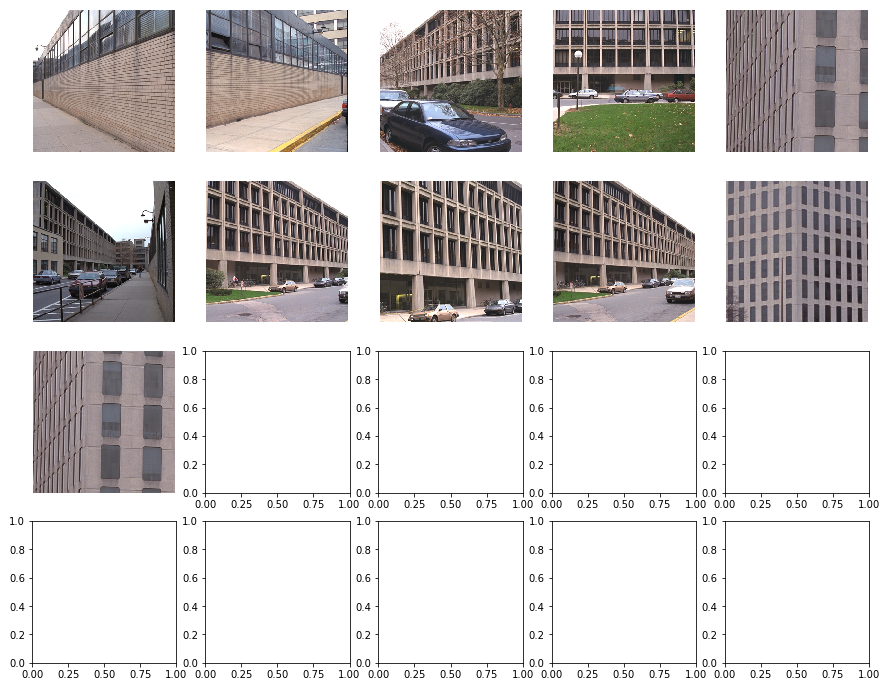



.DS_Store
(0,)


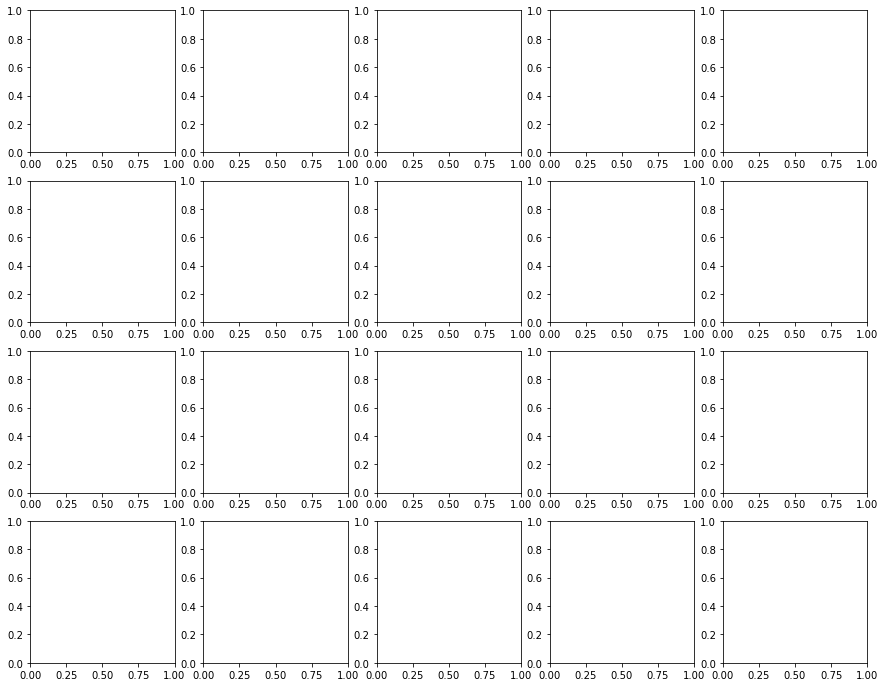



Water
(8, 300, 300, 3)


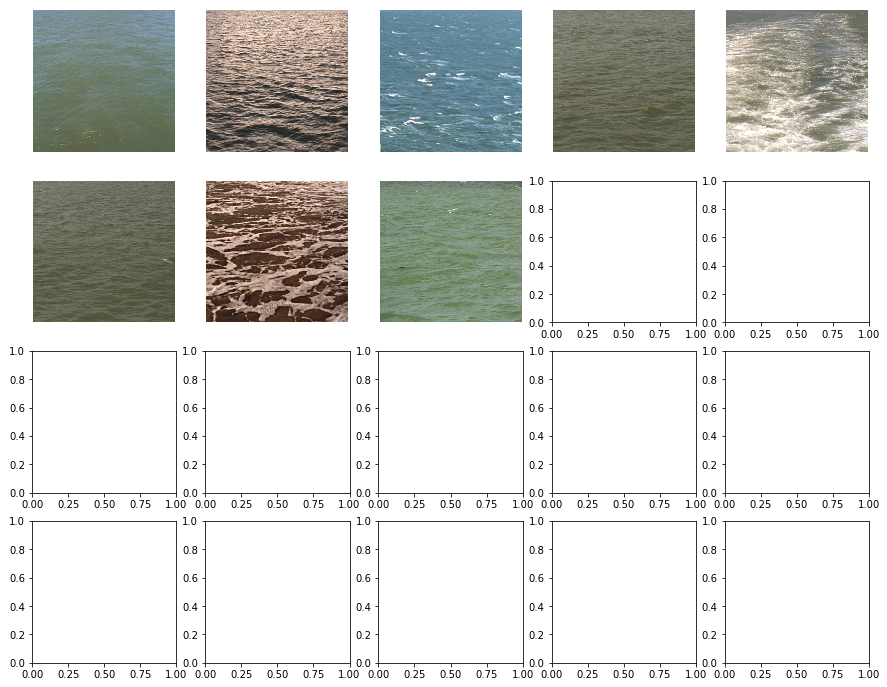



Metal
(6, 300, 300, 3)


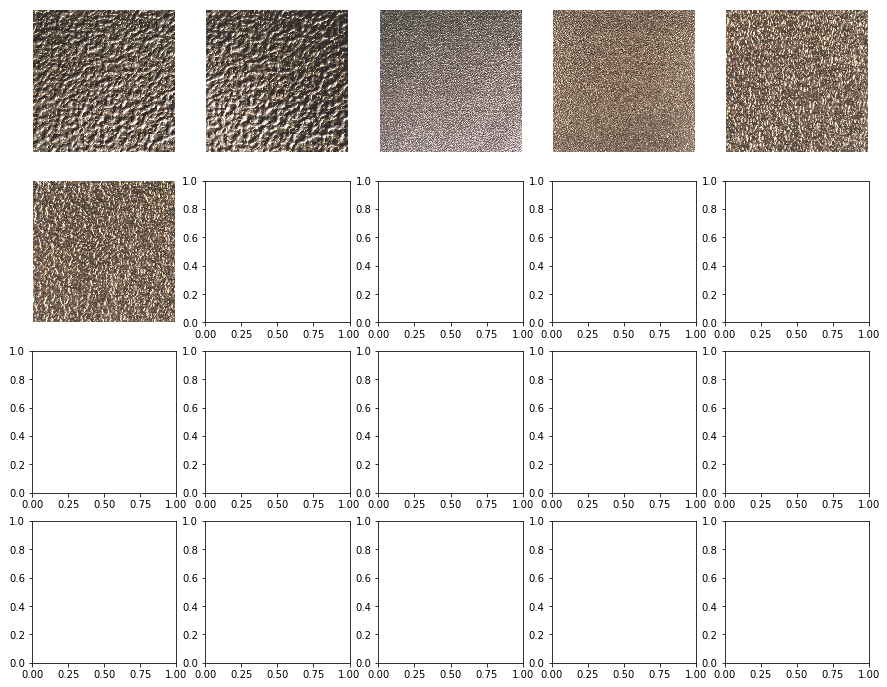



Grass
(3, 300, 300, 3)


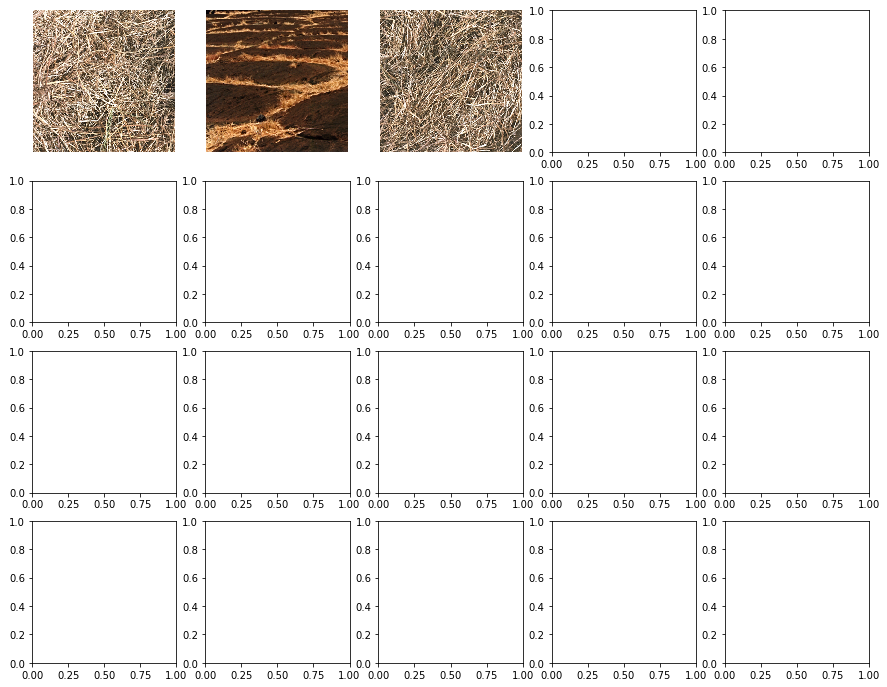



Leaves
(17, 300, 300, 3)


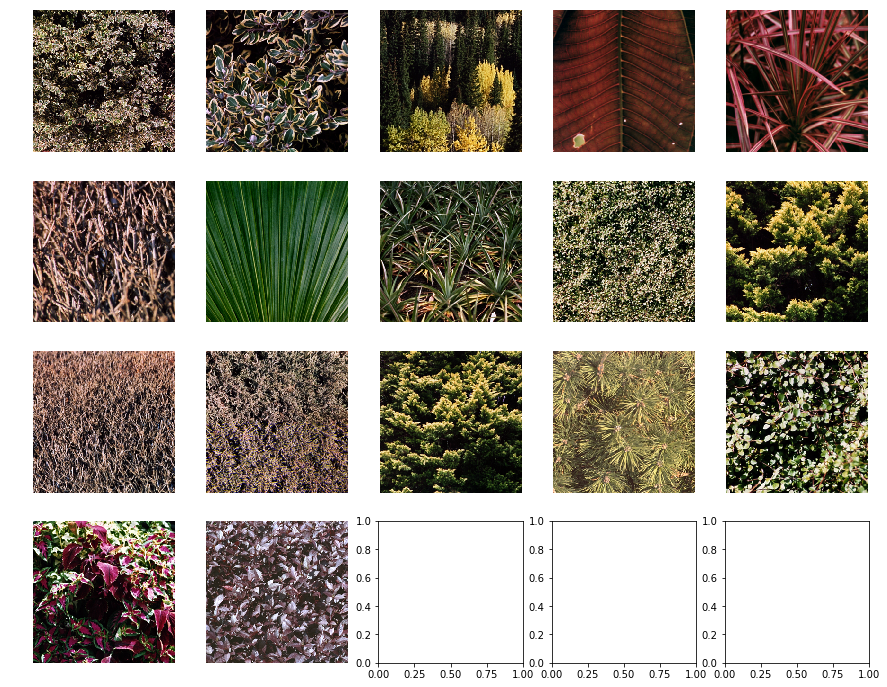



Flowers
(8, 300, 300, 3)


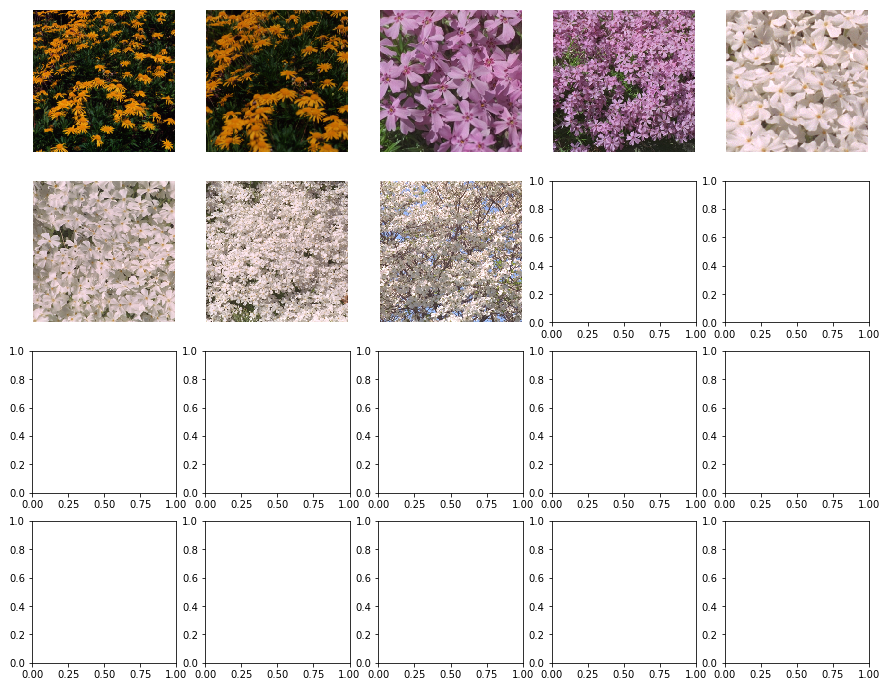



Paintings
(13, 300, 300, 3)


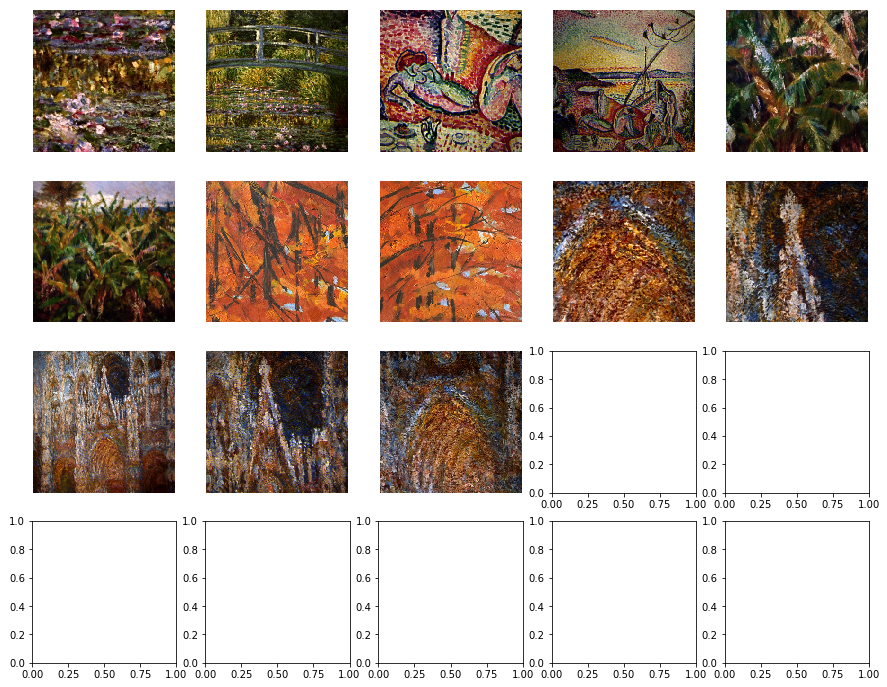



Tile
(11, 300, 300, 3)


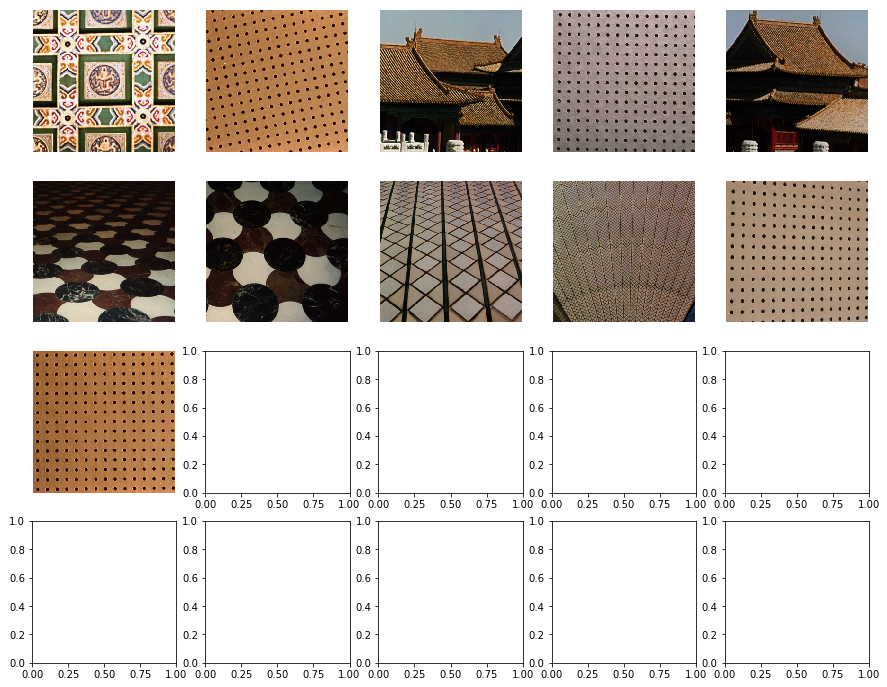



Clouds
(2, 300, 300, 3)


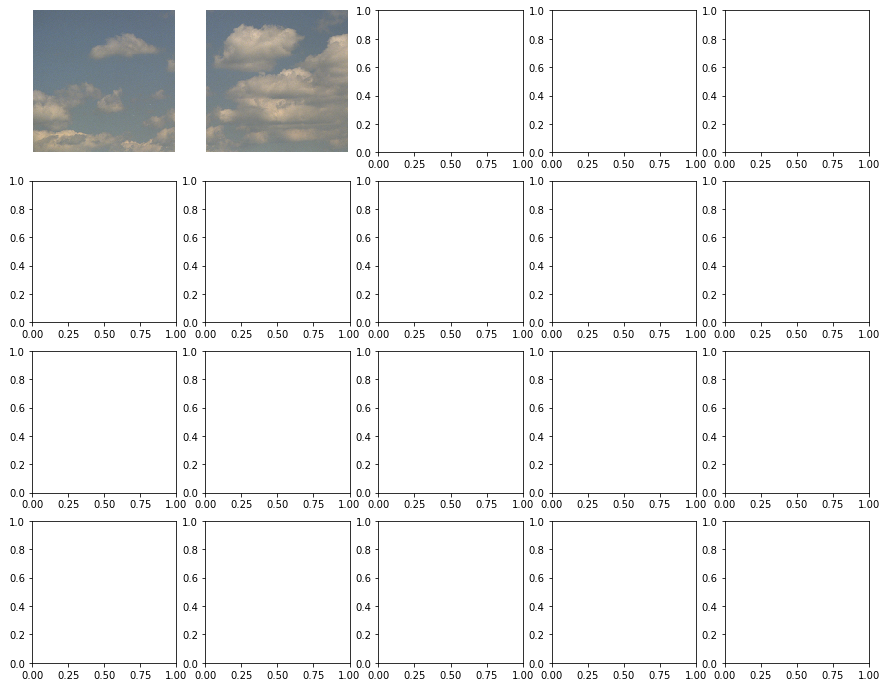



Brick
(9, 300, 300, 3)


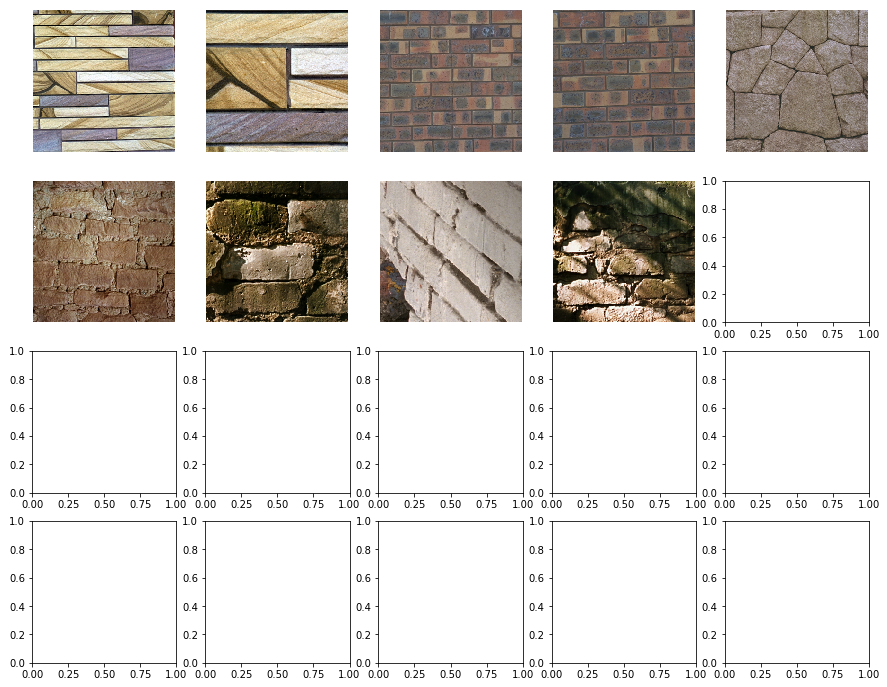



Terrain
(11, 300, 300, 3)


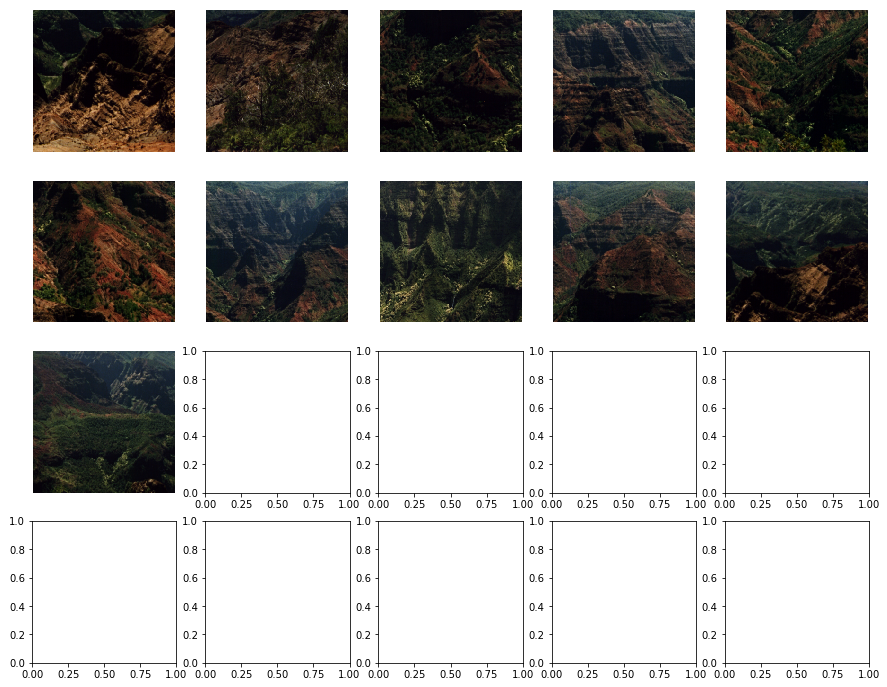



Food
(12, 300, 300, 3)


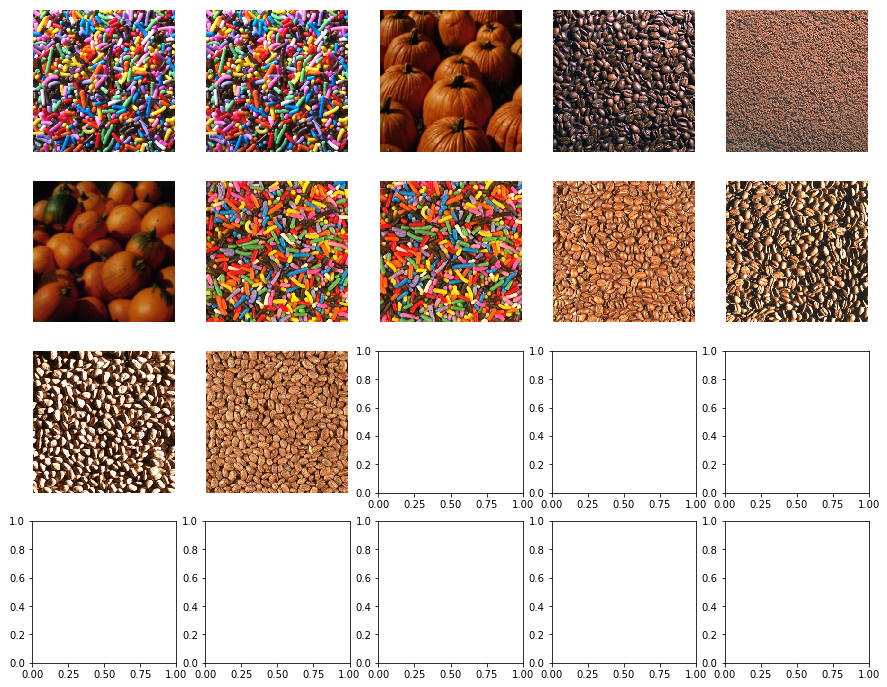



Stone
(6, 300, 300, 3)


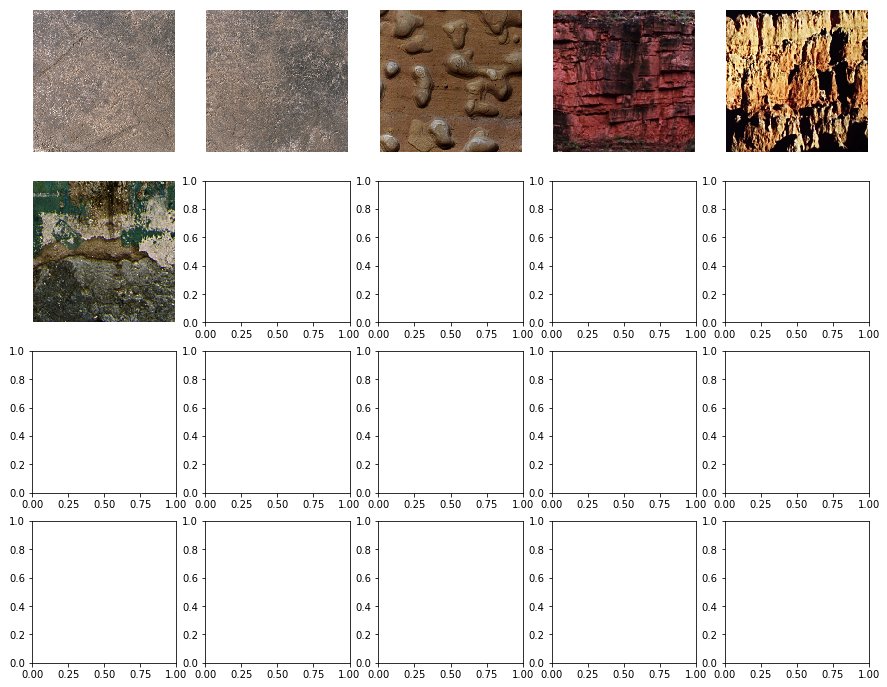



Fabric
(20, 300, 300, 3)


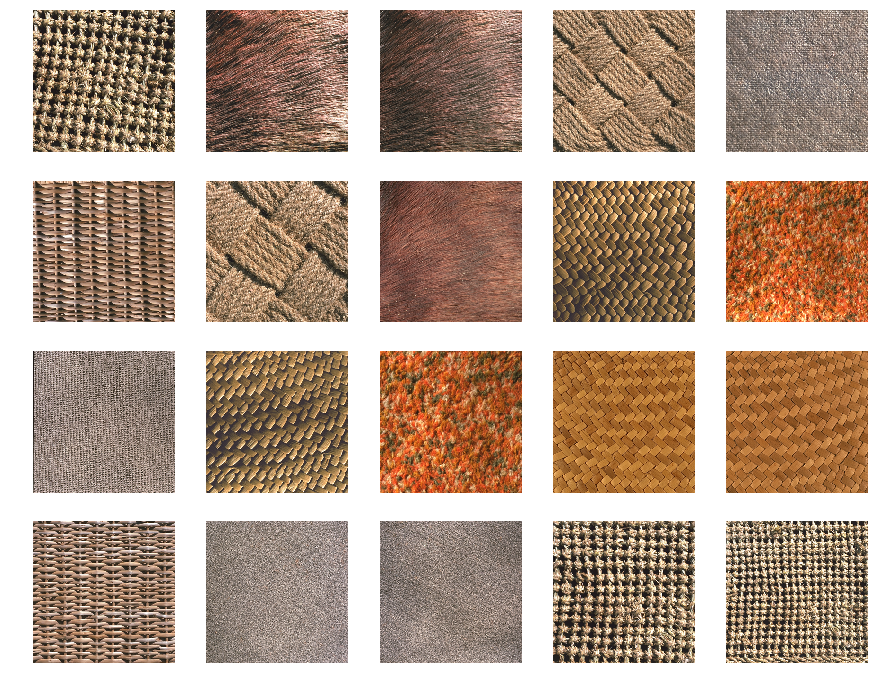



WheresWaldo
(3, 300, 300, 3)


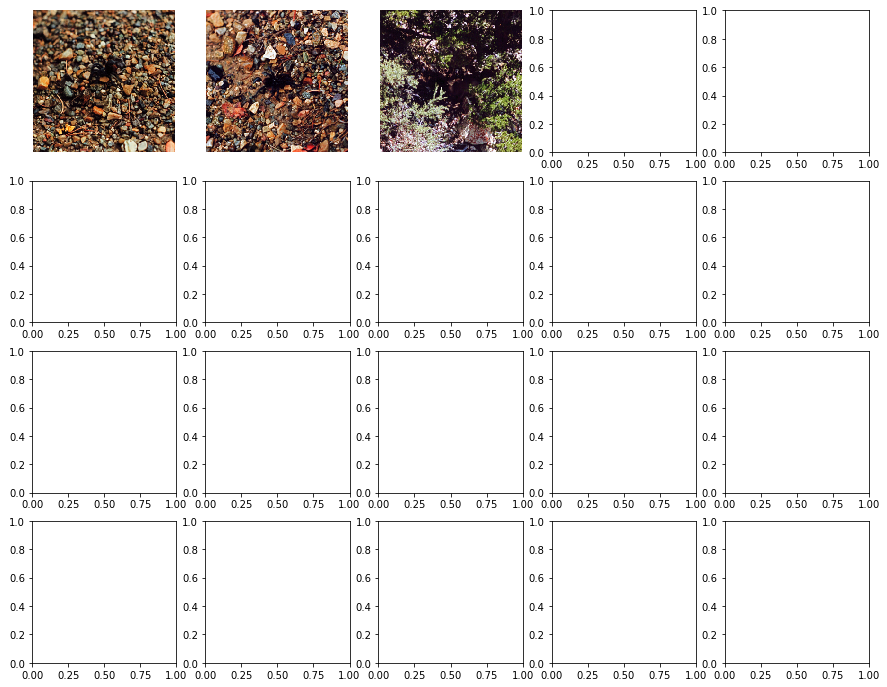



Sand
(7, 300, 300, 3)


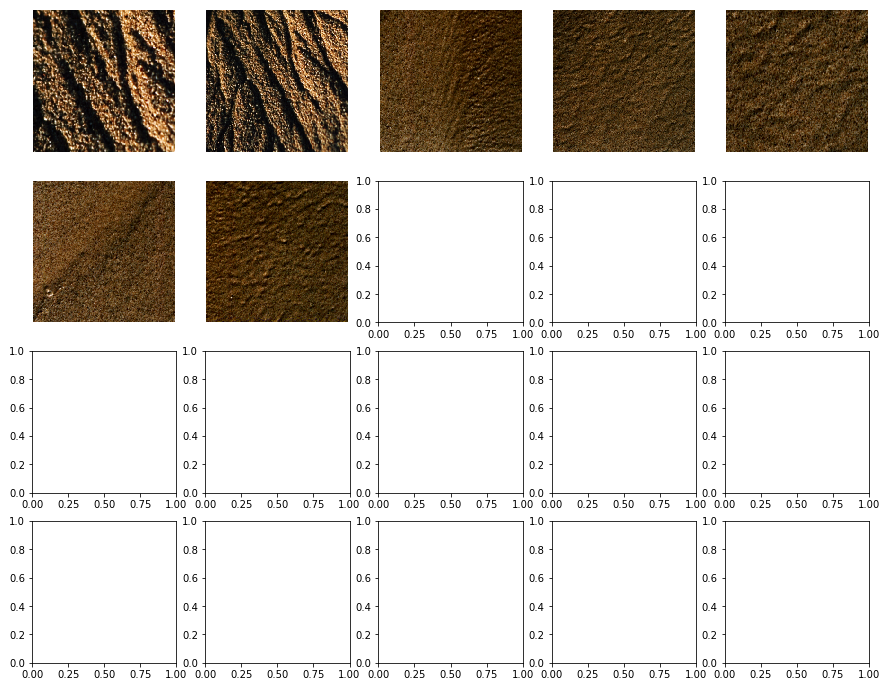

In [22]:
get_images(data_folder1)

In [10]:
data_folder1 = '../data/VisionTexture/VisTex/Images/Reference'
for folder in os.listdir(data_folder1):
    dir_path = os.path.join(data_folder1, folder)
    if os.path.isdir(dir_path):
        files = [f for f in os.listdir(dir_path) if f.endswith('ppm')]
        img_path = os.path.join(dir_path, file) 
        img = image.load_img(img_path, target_size=(300,300), interpolation='bicubic')
        imgs.append(image.img_to_array(img))
    print(folder)
data_folder2 = '../data/VisionTexture/VisTex/Images/Scenes'

Bark
Wood
Misc
Buildings
.DS_Store
Water
Metal
Grass
Leaves
Flowers
Paintings
Tile
Clouds
Brick
Terrain
Food
Stone
Fabric
WheresWaldo
Sand


In [5]:
img = imread('../data/VisionTexture/VisTex/Images/Scenes/BrickPaint/BrickPaint.0000.ppm')

/Users/reubenfeinman/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.


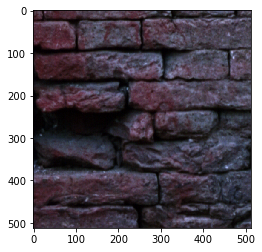

In [7]:
plt.figure()
plt.imshow(img)
plt.show()